<a href="https://colab.research.google.com/github/Akashkunwar/Hackathon-Assignment-for-ML-Engineer/blob/main/Hackathon_Assignment_Smart_Joules.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importing liberaries


In [ ]:
pip install -U kaleido --quiet

     |████████████████████████████████| 79.9 MB 1.2 MB/s 


In [ ]:
pip install sweetviz --q

In [53]:
# Importing important liberary

import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings("ignore")
from functools import reduce
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import sweetviz as sv

## Loading CSV file / Data

In [ ]:
# Reading csv file

df = pd.read_csv('/content/test - train.csv')

In [19]:
df

,building_id,meter,timestamp,meter_reading
0,0,0,2016-01-01,0.000
1,1,0,2016-01-01,0.000
2,2,0,2016-01-01,0.000
3,3,0,2016-01-01,0.000
4,4,0,2016-01-01,0.000
...,...,...,...,...
498508,1444,0,2016-01-10,6.100
498509,1445,0,2016-01-10,4.700
498510,1446,0,2016-01-10,0.000
498511,1447,0,2016-01-10,167.000


## Data Cleaning

In [ ]:
# Changing timestamp to proper datetime format

df['timestamp'] = pd.to_datetime(df.timestamp, format='%Y/%m/%d %H:%M:%S')

In [20]:
df

,building_id,meter,timestamp,meter_reading
0,0,0,2016-01-01,0.000
1,1,0,2016-01-01,0.000
2,2,0,2016-01-01,0.000
3,3,0,2016-01-01,0.000
4,4,0,2016-01-01,0.000
...,...,...,...,...
498508,1444,0,2016-01-10,6.100
498509,1445,0,2016-01-10,4.700
498510,1446,0,2016-01-10,0.000
498511,1447,0,2016-01-10,167.000


In [21]:
# Seperating and creating dateframe according to meter and meter reading

electricity = df[df.meter==0]
chilledwater = df[df.meter==1]
steam = df[df.meter==2]
hotwater = df[df.meter==3]

In [22]:
# Giving correct name to each columns of the datafeame

electricity.rename(columns={'meter_reading': 'electricity'},inplace=True, errors='raise')
chilledwater.rename(columns={'meter_reading': 'chilledwater'},inplace=True, errors='raise')
steam.rename(columns={'meter_reading': 'steam'},inplace=True, errors='raise')
hotwater.rename(columns={'meter_reading': 'hotwater'},inplace=True, errors='raise')

In [23]:
# Merging all 4 dataframe 'electricity', 'steam', 'hotwater', 'chilledwater' in one

data_frames = [electricity, steam, hotwater, chilledwater]
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['building_id','timestamp'], how='outer'), data_frames)
df_merged = df_merged[['building_id', 'timestamp', 'electricity', 'steam', 'hotwater', 'chilledwater']]

In [24]:
# Filling mission values

df_merged = df_merged.fillna(0)
df_merged.rename(columns={'timestamp': 'date'},inplace=True, errors='raise')
df_merged

,building_id,date,electricity,steam,hotwater,chilledwater
0,0,2016-01-01,0.0,0.0,0.0,0.0000
1,1,2016-01-01,0.0,0.0,0.0,0.0000
2,2,2016-01-01,0.0,0.0,0.0,0.0000
3,3,2016-01-01,0.0,0.0,0.0,0.0000
4,4,2016-01-01,0.0,0.0,0.0,0.0000
...,...,...,...,...,...,...
308614,1132,2016-01-10,0.0,0.0,0.0,0.3332
308615,1372,2016-01-10,0.0,0.0,0.0,25.0977
308616,1374,2016-01-10,0.0,0.0,0.0,12.0738
308617,1388,2016-01-10,0.0,0.0,0.0,66.0076


## EDA (Exploratory data analysis)

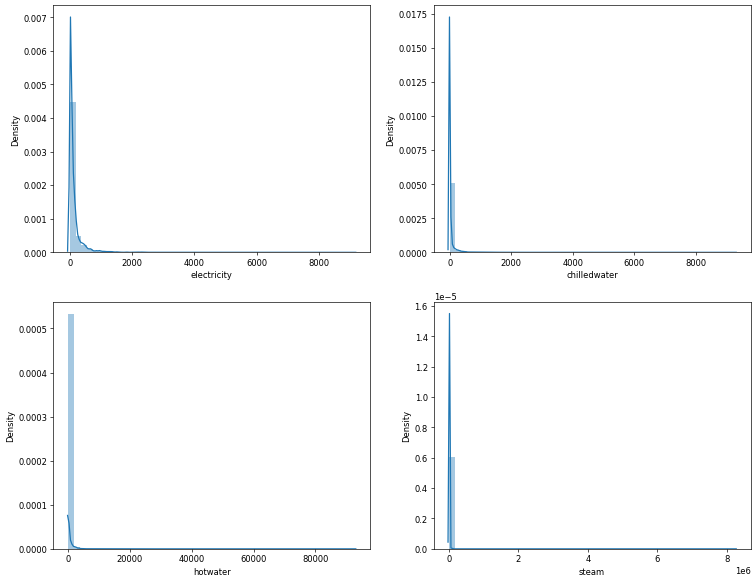

In [26]:
# Checking distribution of all 4 meter 'electricity', 'steam', 'hotwater', 'chilledwater' data

plt.figure(figsize=(15, 12), dpi=60)

plt.subplot(2,2,1)
sns.distplot(df_merged.electricity)

plt.subplot(2,2,2)
sns.distplot(df_merged.chilledwater)

plt.subplot(2,2,3)
sns.distplot(df_merged.hotwater)

plt.subplot(2,2,4)
sns.distplot(df_merged.steam)

plt.show()

In [27]:
# Gettion portion of all meter data

fig = px.pie(df.meter,values = df.meter.value_counts(), names=['electricity', 'chilledwater', 'steam', 'hotwater'], title='Distribution of meter bill')
fig.show()

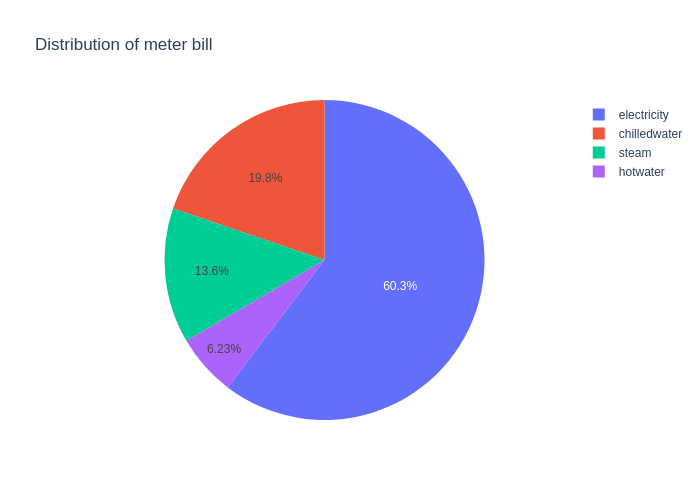

In [28]:
fig = px.pie(df.meter,values = df.meter.value_counts(), names=['electricity', 'chilledwater', 'steam', 'hotwater'], title='Distribution of meter bill')
fig.show('png')

In [29]:
# Plotting function of all  'electricity', 'steam', 'hotwater', 'chilledwater' data saperately accross all dates

def plot_stacked(col):
    fig = px.bar(df_merged, x="date", y=col, 
                 height=600, title=col+' uage by all household in that duration', 
                 color_discrete_sequence = px.colors.cyclical.mygbm)
    fig.update_layout(showlegend=True)
    fig.show()

In [ ]:
plot_stacked('electricity')

In [ ]:
plot_stacked('chilledwater')

In [ ]:
plot_stacked('hotwater')

In [ ]:
plot_stacked('steam')

     |████████████████████████████████| 15.1 MB 40.1 MB/s 


In [41]:
#EDA using Autoviz
sweet_report = sv.analyze(df_merged)

#Saving results to HTML file
sweet_report.show_html('sweet_report.html')

                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [48]:
df_merged.to_csv("df.csv")

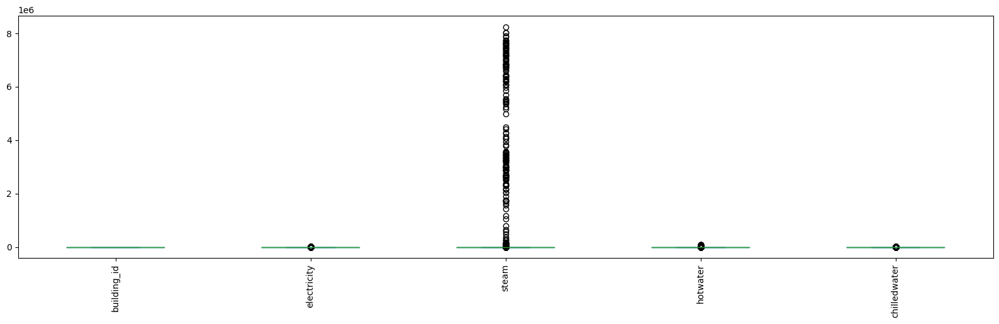

In [49]:
# Range of the data
pd.DataFrame(df_merged, columns=df_merged.columns).plot.box(figsize=(20,5), rot=90)
plt.show()

In [50]:
outliers=[]
def detect_outlier(data_1):
    
    threshold=3
    mean_1 = np.mean(data_1)
    std_1 =np.std(data_1)
    
    
    for y in data_1:
        z_score= (y - mean_1)/std_1 
        if np.abs(z_score) > threshold:
            outliers.append(y)
    return outliers

In [55]:
outlier_datapoints = detect_outlier(df_merged.electricity)
print('Outlier in electricity')
print(outlier_datapoints)

Outlier in electricity
[2027.52, 1139.52, 1701.7, 1216.68, 1384.43, 2994.05, 2179.16, 1967.7, 3987.86, 4791.84, 1517.04, 2316.0, 1350.21, 1497.04, 2024.76, 1714.25, 1241.64, 1446.62, 2823.29, 2172.45, 1967.59, 3937.64, 4855.52, 1517.04, 1146.0, 2316.0, 1350.21, 1488.28, 2033.29, 1731.22, 1282.8, 1432.04, 2862.34, 2182.56, 1964.17, 3969.67, 4859.97, 1517.04, 1143.0, 2322.0, 1344.46, 1462.17, 2028.03, 1773.67, 1237.8, 1433.38, 2856.09, 2182.2, 2121.24, 3919.78, 4876.91, 1517.04, 1146.0, 2314.0, 1345.69, 1470.26, 2016.65, 1926.96, 1231.56, 1429.04, 2856.78, 2168.31, 2094.31, 3945.34, 4831.92, 1517.04, 1150.0, 2322.0, 1349.51, 1439.91, 2027.71, 1134.48, 1962.84, 1240.2, 1403.08, 2851.71, 2166.52, 1959.7, 4084.04, 4816.69, 1517.04, 1151.0, 2310.0, 1344.91, 1478.58, 2026.2, 1142.4, 2042.47, 1233.72, 1394.24, 3021.25, 2176.79, 2467.89, 1475.1, 4738.78, 4835.86, 1517.04, 1155.0, 2340.0, 1338.19, 1140.71, 1447.96, 2022.51, 1159.2, 2073.36, 1161.6, 1143.67, 1497.37, 1386.76, 3780.39, 2335.61, 26

In [56]:
outlier_datapoints = detect_outlier(df_merged.steam)
print('Outlier in steam')
print(outlier_datapoints)

Outlier in steam
[2027.52, 1139.52, 1701.7, 1216.68, 1384.43, 2994.05, 2179.16, 1967.7, 3987.86, 4791.84, 1517.04, 2316.0, 1350.21, 1497.04, 2024.76, 1714.25, 1241.64, 1446.62, 2823.29, 2172.45, 1967.59, 3937.64, 4855.52, 1517.04, 1146.0, 2316.0, 1350.21, 1488.28, 2033.29, 1731.22, 1282.8, 1432.04, 2862.34, 2182.56, 1964.17, 3969.67, 4859.97, 1517.04, 1143.0, 2322.0, 1344.46, 1462.17, 2028.03, 1773.67, 1237.8, 1433.38, 2856.09, 2182.2, 2121.24, 3919.78, 4876.91, 1517.04, 1146.0, 2314.0, 1345.69, 1470.26, 2016.65, 1926.96, 1231.56, 1429.04, 2856.78, 2168.31, 2094.31, 3945.34, 4831.92, 1517.04, 1150.0, 2322.0, 1349.51, 1439.91, 2027.71, 1134.48, 1962.84, 1240.2, 1403.08, 2851.71, 2166.52, 1959.7, 4084.04, 4816.69, 1517.04, 1151.0, 2310.0, 1344.91, 1478.58, 2026.2, 1142.4, 2042.47, 1233.72, 1394.24, 3021.25, 2176.79, 2467.89, 1475.1, 4738.78, 4835.86, 1517.04, 1155.0, 2340.0, 1338.19, 1140.71, 1447.96, 2022.51, 1159.2, 2073.36, 1161.6, 1143.67, 1497.37, 1386.76, 3780.39, 2335.61, 2621.97,

In [59]:
outlier_datapoints = detect_outlier(df_merged.chilledwater)
print('Outlier in chilledwater')
print(outlier_datapoints)

Outlier in chilledwater
[2027.52, 1139.52, 1701.7, 1216.68, 1384.43, 2994.05, 2179.16, 1967.7, 3987.86, 4791.84, 1517.04, 2316.0, 1350.21, 1497.04, 2024.76, 1714.25, 1241.64, 1446.62, 2823.29, 2172.45, 1967.59, 3937.64, 4855.52, 1517.04, 1146.0, 2316.0, 1350.21, 1488.28, 2033.29, 1731.22, 1282.8, 1432.04, 2862.34, 2182.56, 1964.17, 3969.67, 4859.97, 1517.04, 1143.0, 2322.0, 1344.46, 1462.17, 2028.03, 1773.67, 1237.8, 1433.38, 2856.09, 2182.2, 2121.24, 3919.78, 4876.91, 1517.04, 1146.0, 2314.0, 1345.69, 1470.26, 2016.65, 1926.96, 1231.56, 1429.04, 2856.78, 2168.31, 2094.31, 3945.34, 4831.92, 1517.04, 1150.0, 2322.0, 1349.51, 1439.91, 2027.71, 1134.48, 1962.84, 1240.2, 1403.08, 2851.71, 2166.52, 1959.7, 4084.04, 4816.69, 1517.04, 1151.0, 2310.0, 1344.91, 1478.58, 2026.2, 1142.4, 2042.47, 1233.72, 1394.24, 3021.25, 2176.79, 2467.89, 1475.1, 4738.78, 4835.86, 1517.04, 1155.0, 2340.0, 1338.19, 1140.71, 1447.96, 2022.51, 1159.2, 2073.36, 1161.6, 1143.67, 1497.37, 1386.76, 3780.39, 2335.61, 2

In [60]:
outlier_datapoints = detect_outlier(df_merged.hotwater)
print('Outlier in hotwater')
print(outlier_datapoints)

Outlier in hotwater
[2027.52, 1139.52, 1701.7, 1216.68, 1384.43, 2994.05, 2179.16, 1967.7, 3987.86, 4791.84, 1517.04, 2316.0, 1350.21, 1497.04, 2024.76, 1714.25, 1241.64, 1446.62, 2823.29, 2172.45, 1967.59, 3937.64, 4855.52, 1517.04, 1146.0, 2316.0, 1350.21, 1488.28, 2033.29, 1731.22, 1282.8, 1432.04, 2862.34, 2182.56, 1964.17, 3969.67, 4859.97, 1517.04, 1143.0, 2322.0, 1344.46, 1462.17, 2028.03, 1773.67, 1237.8, 1433.38, 2856.09, 2182.2, 2121.24, 3919.78, 4876.91, 1517.04, 1146.0, 2314.0, 1345.69, 1470.26, 2016.65, 1926.96, 1231.56, 1429.04, 2856.78, 2168.31, 2094.31, 3945.34, 4831.92, 1517.04, 1150.0, 2322.0, 1349.51, 1439.91, 2027.71, 1134.48, 1962.84, 1240.2, 1403.08, 2851.71, 2166.52, 1959.7, 4084.04, 4816.69, 1517.04, 1151.0, 2310.0, 1344.91, 1478.58, 2026.2, 1142.4, 2042.47, 1233.72, 1394.24, 3021.25, 2176.79, 2467.89, 1475.1, 4738.78, 4835.86, 1517.04, 1155.0, 2340.0, 1338.19, 1140.71, 1447.96, 2022.51, 1159.2, 2073.36, 1161.6, 1143.67, 1497.37, 1386.76, 3780.39, 2335.61, 2621.

In [61]:
pip install session-info

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 63 kB 2.6 MB/s 
  Created wheel for session-info: filename=session_info-1.0.0-py3-none-any.whl size=8044 sha256=83fe8b335d33eb6d3f4bb7d978e8c0d8a883bae8b0143753a245e26b05b377db
  Stored in directory: /root/.cache/pip/wheels/bd/ad/14/6a42359351a18337a8683854cfbba99dd782271f2d1767f87f
Successfully built session-info


In [62]:
import session_info
session_info.show()